In [1]:
# Import Libraries
import pandas as pd
!pip install prophet
from prophet import Prophet
from prophet.plot import add_changepoints_to_plot
import warnings
warnings.filterwarnings("ignore")


[notice] A new release of pip is available: 23.2.1 -> 23.3.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
coke_df = pd.read_csv("KO.csv")
coke_df.head(), coke_df.tail()


(         Date      Open      High       Low     Close  Adj Close    Volume
 0  1990-11-29  5.687500  5.734375  5.546875  5.593750   2.593405   6990400
 1  1990-11-30  5.593750  5.828125  5.562500  5.781250   2.680335  12562400
 2  1990-12-03  5.781250  5.875000  5.765625  5.843750   2.709311   8604800
 3  1990-12-04  5.843750  5.875000  5.703125  5.859375   2.716555   5730400
 4  1990-12-05  5.859375  5.953125  5.812500  5.937500   2.752775   6846400,
             Date       Open       High        Low      Close  Adj Close  \
 8307  2023-11-21  57.459999  58.040001  57.330002  58.029999  58.029999   
 8308  2023-11-22  58.259998  58.540001  58.130001  58.419998  58.419998   
 8309  2023-11-24  58.459999  58.750000  58.340000  58.570000  58.570000   
 8310  2023-11-27  58.540001  58.689999  58.270000  58.459999  58.459999   
 8311  2023-11-28  58.400002  58.830002  58.360001  58.580002  58.580002   
 
         Volume  
 8307  13891600  
 8308  11320600  
 8309   4816000  
 8310  162465

In [3]:
coke_df.shape


(8312, 7)

In [4]:
# Create df with date and price cols
coke_df = coke_df[["Date", "Close"]]
coke_df.head(), coke_df.tail()

(         Date     Close
 0  1990-11-29  5.593750
 1  1990-11-30  5.781250
 2  1990-12-03  5.843750
 3  1990-12-04  5.859375
 4  1990-12-05  5.937500,
             Date      Close
 8307  2023-11-21  58.029999
 8308  2023-11-22  58.419998
 8309  2023-11-24  58.570000
 8310  2023-11-27  58.459999
 8311  2023-11-28  58.580002)

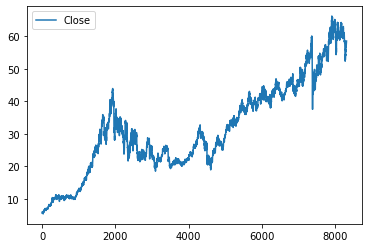

In [5]:
from matplotlib import pyplot
coke_df.plot()
pyplot.show()

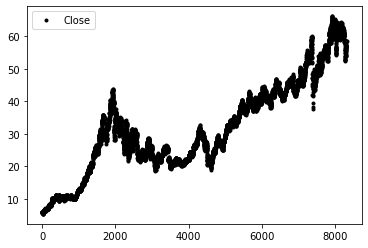

In [6]:
coke_df.plot(style='k.')
pyplot.show()

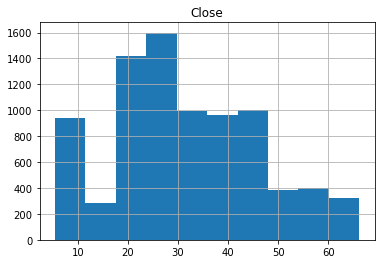

In [7]:
coke_df.hist()
pyplot.show()

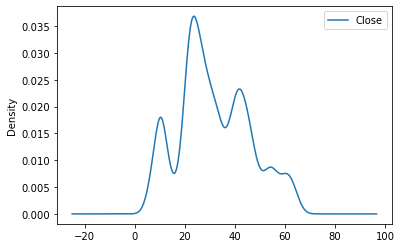

In [8]:
coke_df.plot(kind='kde')
pyplot.show()

In [9]:
coke_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8312 entries, 0 to 8311
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    8312 non-null   object 
 1   Close   8312 non-null   float64
dtypes: float64(1), object(1)
memory usage: 130.0+ KB


In [10]:
coke_stock_df = pd.DataFrame()
coke_stock_df['ds'] = pd.to_datetime(coke_df['Date'])
coke_stock_df['y'] = coke_df['Close']
coke_stock_df.head(), coke_stock_df.tail()

(          ds         y
 0 1990-11-29  5.593750
 1 1990-11-30  5.781250
 2 1990-12-03  5.843750
 3 1990-12-04  5.859375
 4 1990-12-05  5.937500,
              ds          y
 8307 2023-11-21  58.029999
 8308 2023-11-22  58.419998
 8309 2023-11-24  58.570000
 8310 2023-11-27  58.459999
 8311 2023-11-28  58.580002)

In [11]:
# Initialize model
prophet_model = Prophet(interval_width=0.95)
prophet_model.fit(coke_stock_df)

16:34:59 - cmdstanpy - INFO - Chain [1] start processing
16:35:02 - cmdstanpy - INFO - Chain [1] done processing


#  Forecast for 6 months

In [12]:
six_month_future = prophet_model.make_future_dataframe(periods=6*30, freq='D')

In [13]:
six_month_forecast = prophet_model.predict(six_month_future)

In [14]:
six_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].head()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
0,1990-11-29,6.231077,2.051928,10.883861,5.832525,5.832525,5.832525
1,1990-11-30,6.243267,1.858176,10.590936,5.840790,5.840790,5.840790
2,1990-12-03,6.264474,1.597091,10.333193,5.865586,5.865586,5.865586
3,1990-12-04,6.292977,2.206444,10.566060,5.873851,5.873851,5.873851
4,1990-12-05,6.303088,2.156038,10.216830,5.882116,5.882116,5.882116


In [15]:
six_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
8487,2024-05-22,64.331602,59.696874,68.563463,63.797403,62.606753,65.039750
8488,2024-05-23,64.336526,60.049625,68.501773,63.805471,62.604849,65.060370
8489,2024-05-24,64.357536,59.977278,68.893204,63.813539,62.602945,65.080989
8490,2024-05-25,64.175528,59.685121,68.503374,63.821607,62.601040,65.101608
8491,2024-05-26,64.192926,59.754372,68.644388,63.829675,62.599136,65.122168


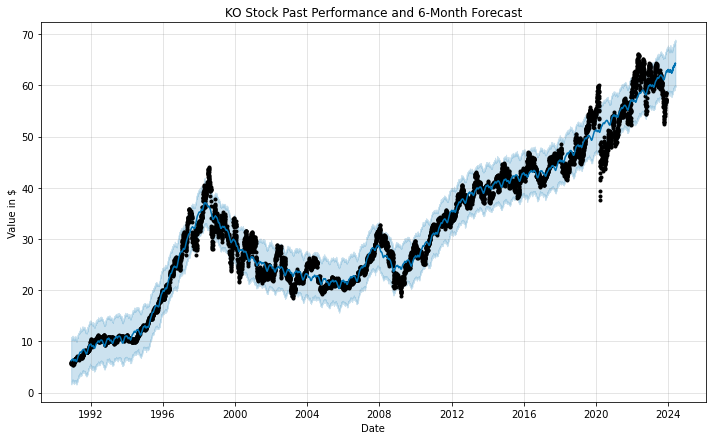

In [16]:
import matplotlib.pyplot as plt
trend_plot = prophet_model.plot(six_month_forecast)
plt.title('KO Stock Past Performance and 6-Month Forecast')
plt.xlabel('Date')
plt.ylabel('Value in $')

trend_plot.show()

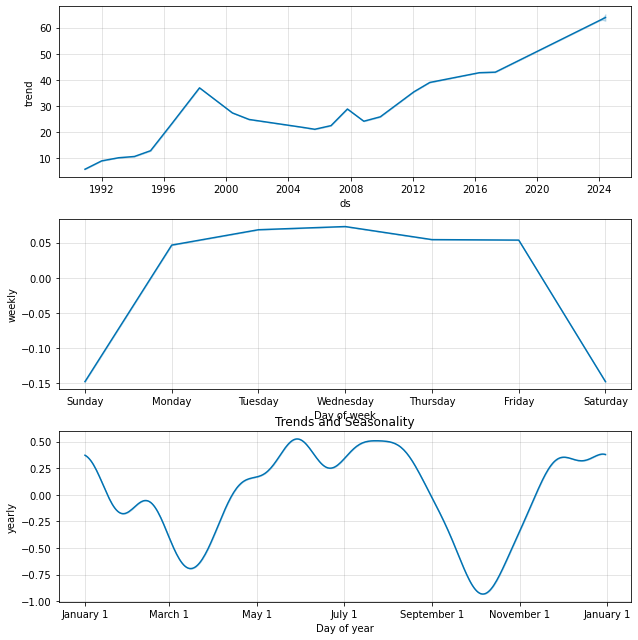

In [17]:
six_month_performance_plot = prophet_model.plot_components(six_month_forecast)
plt.title('Trends and Seasonality')
six_month_performance_plot.show()


[[<matplotlib.lines.Line2D at 0x1e3683d5a90>],

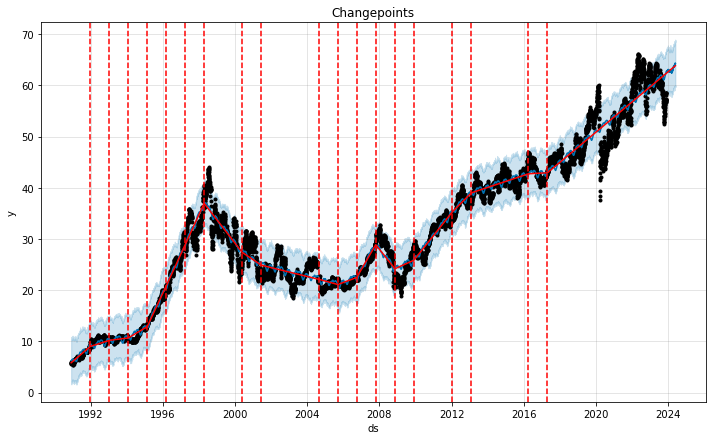

In [18]:
# Trends and seasonality
trend_plot = prophet_model.plot(six_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       prophet_model, six_month_forecast)
plt.title("Changepoints")
trends_and_seasonality_plot

In [19]:
from prophet.diagnostics import cross_validation
six_month_cv = cross_validation(prophet_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/61 [00:00<?, ?it/s]

16:35:34 - cmdstanpy - INFO - Chain [1] start processing
16:35:34 - cmdstanpy - INFO - Chain [1] done processing
16:35:35 - cmdstanpy - INFO - Chain [1] start processing
16:35:35 - cmdstanpy - INFO - Chain [1] done processing
16:35:35 - cmdstanpy - INFO - Chain [1] start processing
16:35:35 - cmdstanpy - INFO - Chain [1] done processing
16:35:35 - cmdstanpy - INFO - Chain [1] start processing
16:35:36 - cmdstanpy - INFO - Chain [1] done processing
16:35:36 - cmdstanpy - INFO - Chain [1] start processing
16:35:36 - cmdstanpy - INFO - Chain [1] done processing
16:35:36 - cmdstanpy - INFO - Chain [1] start processing
16:35:37 - cmdstanpy - INFO - Chain [1] done processing
16:35:37 - cmdstanpy - INFO - Chain [1] start processing
16:35:37 - cmdstanpy - INFO - Chain [1] done processing
16:35:37 - cmdstanpy - INFO - Chain [1] start processing
16:35:38 - cmdstanpy - INFO - Chain [1] done processing
16:35:38 - cmdstanpy - INFO - Chain [1] start processing
16:35:38 - cmdstanpy - INFO - Chain [1]

In [20]:
six_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-05-05,9.939147,9.505909,10.374859,9.812500,1993-05-04
1,1993-05-06,9.978941,9.537183,10.399442,9.718750,1993-05-04
2,1993-05-07,9.989581,9.562807,10.415951,9.687500,1993-05-04
3,1993-05-10,10.072743,9.618043,10.560653,9.781250,1993-05-04
4,1993-05-11,10.080418,9.643686,10.508435,10.031250,1993-05-04
...,...,...,...,...,...,...
15345,2023-11-21,62.427187,56.998305,67.988646,58.029999,2022-11-28
15346,2023-11-22,62.445992,57.145511,67.659175,58.419998,2022-11-28
15347,2023-11-24,62.454819,56.978004,67.653271,58.570000,2022-11-28
15348,2023-11-27,62.475019,56.840691,68.190379,58.459999,2022-11-28


In [21]:
# Performance metrics
from prophet.diagnostics import performance_metrics
six_month_performance_df = performance_metrics(six_month_cv)
six_month_performance_df


,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,8.933444,2.988887,2.375877,0.075451,0.063797,0.074968,0.685766
1,38 days,9.030246,3.005037,2.388666,0.075841,0.064274,0.075428,0.681513
2,39 days,9.171865,3.028509,2.406822,0.076272,0.064316,0.075917,0.677059
3,40 days,9.232783,3.038549,2.415404,0.076339,0.064710,0.076071,0.676066
4,41 days,9.247164,3.040915,2.416920,0.076286,0.065219,0.076057,0.675843
...,...,...,...,...,...,...,...,...
324,361 days,26.209452,5.119517,3.943430,0.129060,0.089391,0.126766,0.704159
325,362 days,26.291583,5.127532,3.948980,0.129411,0.089391,0.127075,0.704452
326,363 days,26.363526,5.134542,3.952967,0.129760,0.090121,0.127410,0.706189
327,364 days,26.592953,5.156836,3.964330,0.130282,0.090406,0.127872,0.707399


In [22]:
six_month_performance_df.iloc[143], six_month_performance_df.iloc[328]


(horizon     180 days 00:00:00
 mse                  15.72961
 rmse                 3.966057
 mae                  3.136961
 mape                 0.105742
 mdape                0.084921
 smape                0.104647
 coverage             0.534658
 Name: 143, dtype: object,
 horizon     365 days 00:00:00
 mse                  26.62567
 rmse                 5.160007
 mae                  3.955674
 mape                 0.129944
 mdape                0.090121
 smape                0.127467
 coverage             0.710219
 Name: 328, dtype: object)

#  Forecast for 12 months

In [23]:
twelve_month_future = prophet_model.make_future_dataframe(periods=12*30, freq='D')

In [24]:
twelve_month_forecast = prophet_model.predict(twelve_month_future)

In [25]:
twelve_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
8667,2024-11-18,65.469283,60.176885,70.684429,65.249626,62.003129,68.863542
8668,2024-11-19,65.524322,60.293958,70.670516,65.257694,61.968298,68.882890
8669,2024-11-20,65.560485,60.160490,71.241443,65.265762,61.933466,68.902238
8670,2024-11-21,65.571858,60.708021,70.543415,65.273830,61.919193,68.931180
8671,2024-11-22,65.599306,60.081946,71.219161,65.281898,61.907628,68.962532


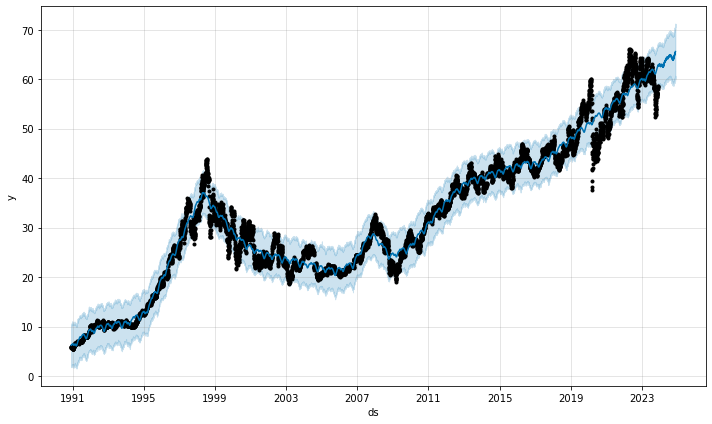

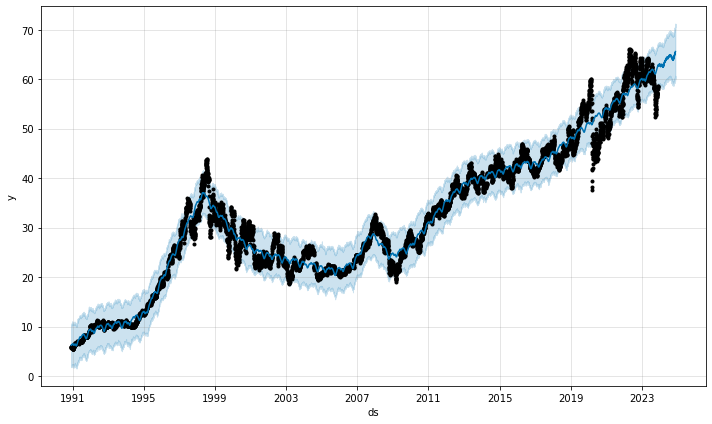

In [26]:
trend_plot = prophet_model.plot(twelve_month_forecast)
trend_plot

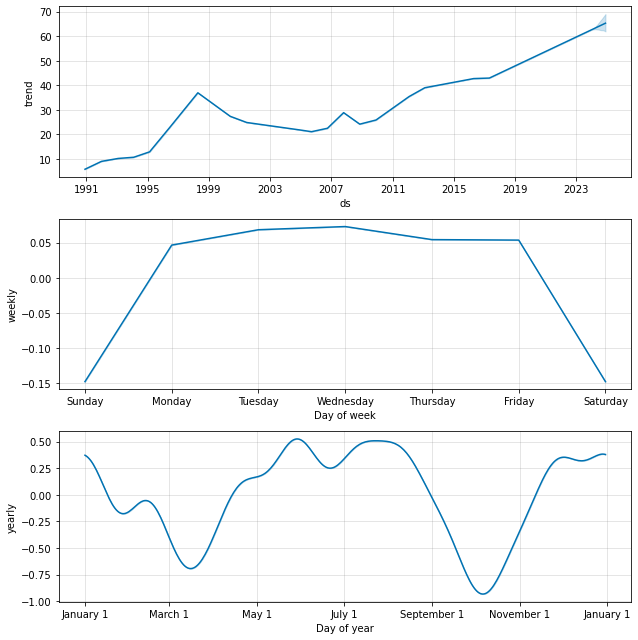

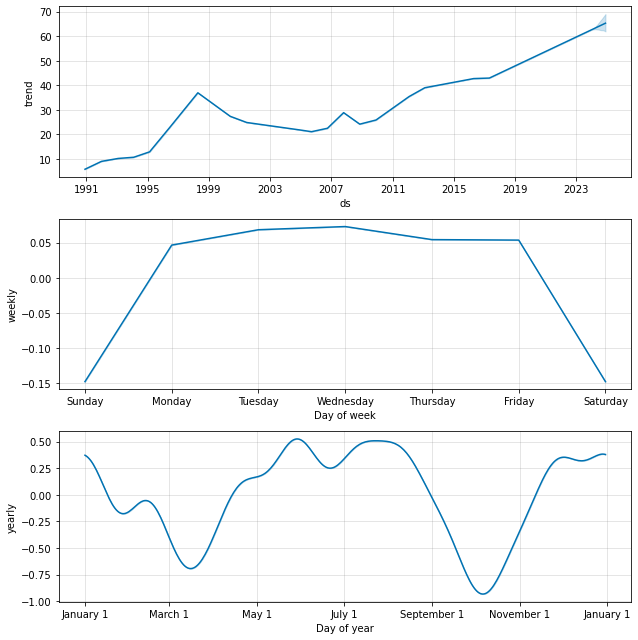

In [27]:
twelve_month_performance_plot = prophet_model.plot_components(twelve_month_forecast)
twelve_month_performance_plot


[[<matplotlib.lines.Line2D at 0x1e3681a0070>],

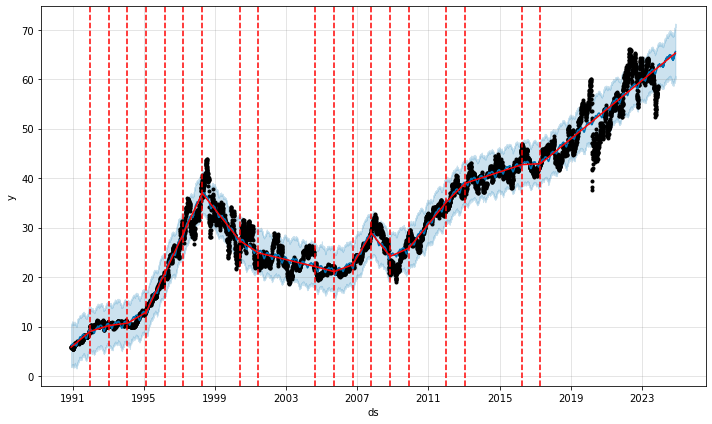

In [28]:
# Trends and seasonality
trend_plot = prophet_model.plot(twelve_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       prophet_model, twelve_month_forecast)
trends_and_seasonality_plot

In [29]:
from prophet.diagnostics import cross_validation
twelve_month_cv = cross_validation(prophet_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/61 [00:00<?, ?it/s]

16:37:48 - cmdstanpy - INFO - Chain [1] start processing
16:37:48 - cmdstanpy - INFO - Chain [1] done processing
16:37:48 - cmdstanpy - INFO - Chain [1] start processing
16:37:48 - cmdstanpy - INFO - Chain [1] done processing
16:37:48 - cmdstanpy - INFO - Chain [1] start processing
16:37:49 - cmdstanpy - INFO - Chain [1] done processing
16:37:49 - cmdstanpy - INFO - Chain [1] start processing
16:37:49 - cmdstanpy - INFO - Chain [1] done processing
16:37:49 - cmdstanpy - INFO - Chain [1] start processing
16:37:50 - cmdstanpy - INFO - Chain [1] done processing
16:37:50 - cmdstanpy - INFO - Chain [1] start processing
16:37:50 - cmdstanpy - INFO - Chain [1] done processing
16:37:50 - cmdstanpy - INFO - Chain [1] start processing
16:37:51 - cmdstanpy - INFO - Chain [1] done processing
16:37:51 - cmdstanpy - INFO - Chain [1] start processing
16:37:51 - cmdstanpy - INFO - Chain [1] done processing
16:37:51 - cmdstanpy - INFO - Chain [1] start processing
16:37:52 - cmdstanpy - INFO - Chain [1]

In [30]:
twelve_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-05-05,9.939147,9.502990,10.346581,9.812500,1993-05-04
1,1993-05-06,9.978941,9.556452,10.438582,9.718750,1993-05-04
2,1993-05-07,9.989581,9.572249,10.458211,9.687500,1993-05-04
3,1993-05-10,10.072743,9.649017,10.544345,9.781250,1993-05-04
4,1993-05-11,10.080418,9.656831,10.516214,10.031250,1993-05-04
...,...,...,...,...,...,...
15345,2023-11-21,62.427187,57.273979,68.306862,58.029999,2022-11-28
15346,2023-11-22,62.445992,56.946812,67.844622,58.419998,2022-11-28
15347,2023-11-24,62.454819,56.872024,67.899711,58.570000,2022-11-28
15348,2023-11-27,62.475019,56.674652,68.584582,58.459999,2022-11-28


In [31]:
# Performance metrics
from prophet.diagnostics import performance_metrics
twelve_month_performance_df = performance_metrics(twelve_month_cv)
twelve_month_performance_df


,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,8.933444,2.988887,2.375877,0.075451,0.063797,0.074968,0.690645
1,38 days,9.030246,3.005037,2.388666,0.075841,0.064274,0.075428,0.685739
2,39 days,9.171865,3.028509,2.406822,0.076272,0.064316,0.075917,0.679975
3,40 days,9.232783,3.038549,2.415404,0.076339,0.064710,0.076071,0.677959
4,41 days,9.247164,3.040915,2.416920,0.076286,0.065219,0.076057,0.677494
...,...,...,...,...,...,...,...,...
324,361 days,26.209452,5.119517,3.943430,0.129060,0.089391,0.126766,0.710022
325,362 days,26.291583,5.127532,3.948980,0.129411,0.089391,0.127075,0.710470
326,363 days,26.363526,5.134542,3.952967,0.129760,0.090121,0.127410,0.712564
327,364 days,26.592953,5.156836,3.964330,0.130282,0.090406,0.127872,0.713262


# Forecast for 18 months

In [32]:
eighteen_month_future = prophet_model.make_future_dataframe(periods=18*30, freq='D')

In [33]:
eighteen_month_forecast = prophet_model.predict(eighteen_month_future)

In [34]:
eighteen_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
8847,2025-05-17,66.915720,59.915685,74.861119,66.701849,59.979862,73.394954
8848,2025-05-18,66.943933,59.613255,74.793196,66.709917,59.968698,73.417917
8849,2025-05-19,67.166473,60.252779,74.697645,66.717985,59.957534,73.440879
8850,2025-05-20,67.215786,60.216399,75.221801,66.726052,59.946370,73.463842
8851,2025-05-21,67.246874,59.428199,75.442331,66.734120,59.935205,73.486805


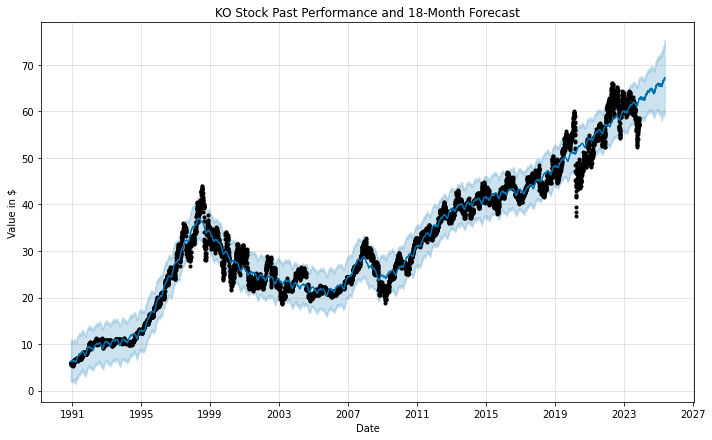

In [35]:
trend_plot = prophet_model.plot(eighteen_month_forecast)
plt.title('KO Stock Past Performance and 18-Month Forecast')
plt.xlabel('Date')
plt.ylabel('Value in $')

trend_plot.show()

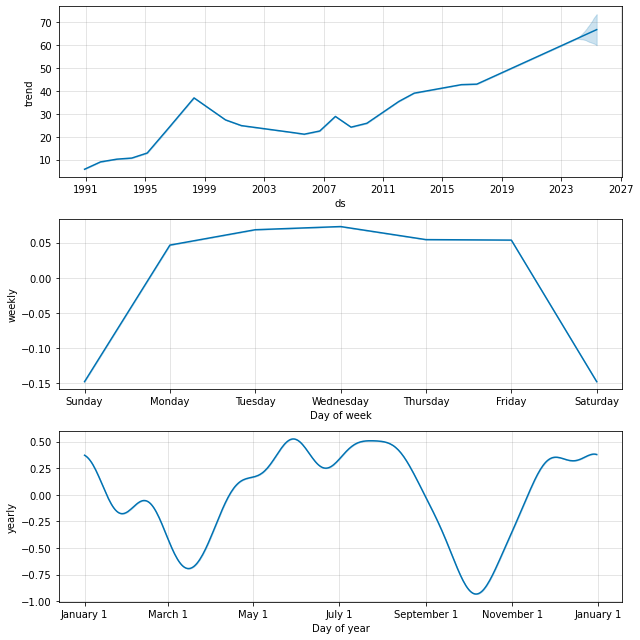

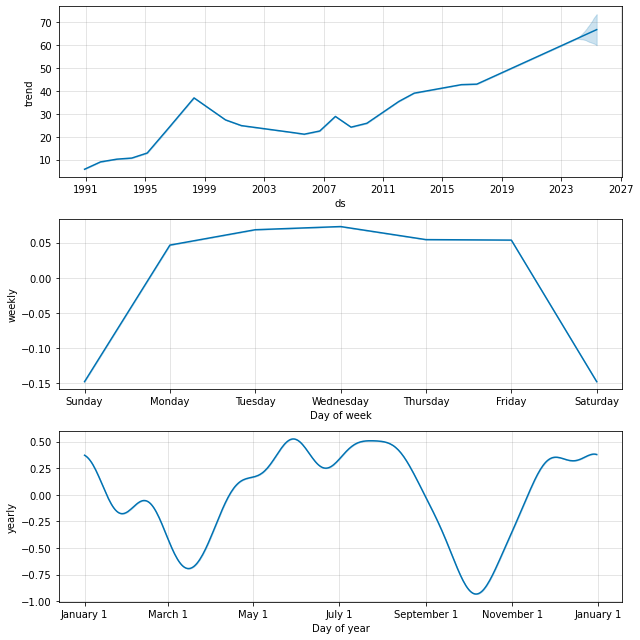

In [36]:
eighteen_month_performance_plot = prophet_model.plot_components(eighteen_month_forecast)
eighteen_month_performance_plot

[[<matplotlib.lines.Line2D at 0x1e36cf799d0>],

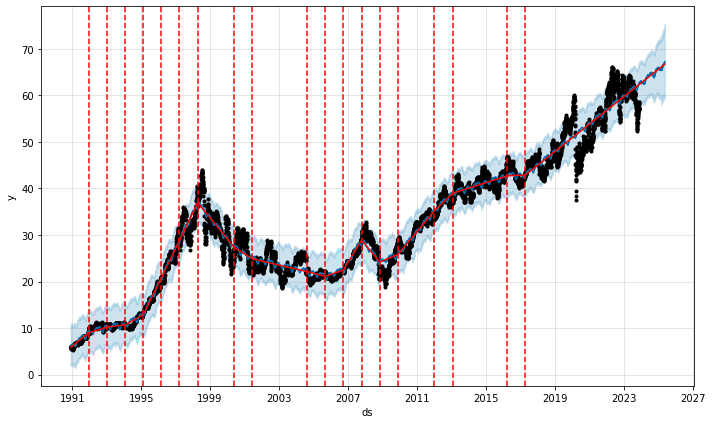

In [37]:
# Trends and seasonality
trend_plot = prophet_model.plot(eighteen_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       prophet_model, eighteen_month_forecast)
trends_and_seasonality_plot

In [38]:
from prophet.diagnostics import cross_validation
eighteen_month_cv = cross_validation(prophet_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/61 [00:00<?, ?it/s]

16:40:20 - cmdstanpy - INFO - Chain [1] start processing
16:40:21 - cmdstanpy - INFO - Chain [1] done processing
16:40:21 - cmdstanpy - INFO - Chain [1] start processing
16:40:21 - cmdstanpy - INFO - Chain [1] done processing
16:40:21 - cmdstanpy - INFO - Chain [1] start processing
16:40:21 - cmdstanpy - INFO - Chain [1] done processing
16:40:21 - cmdstanpy - INFO - Chain [1] start processing
16:40:22 - cmdstanpy - INFO - Chain [1] done processing
16:40:22 - cmdstanpy - INFO - Chain [1] start processing
16:40:22 - cmdstanpy - INFO - Chain [1] done processing
16:40:22 - cmdstanpy - INFO - Chain [1] start processing
16:40:23 - cmdstanpy - INFO - Chain [1] done processing
16:40:23 - cmdstanpy - INFO - Chain [1] start processing
16:40:23 - cmdstanpy - INFO - Chain [1] done processing
16:40:24 - cmdstanpy - INFO - Chain [1] start processing
16:40:24 - cmdstanpy - INFO - Chain [1] done processing
16:40:24 - cmdstanpy - INFO - Chain [1] start processing
16:40:24 - cmdstanpy - INFO - Chain [1]

In [39]:
eighteen_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-05-05,9.939147,9.469380,10.398686,9.812500,1993-05-04
1,1993-05-06,9.978941,9.546909,10.391572,9.718750,1993-05-04
2,1993-05-07,9.989581,9.536611,10.433748,9.687500,1993-05-04
3,1993-05-10,10.072743,9.648380,10.496570,9.781250,1993-05-04
4,1993-05-11,10.080418,9.612922,10.539664,10.031250,1993-05-04
...,...,...,...,...,...,...
15345,2023-11-21,62.427187,57.163868,67.789865,58.029999,2022-11-28
15346,2023-11-22,62.445992,57.440482,68.304207,58.419998,2022-11-28
15347,2023-11-24,62.454819,57.592318,68.388492,58.570000,2022-11-28
15348,2023-11-27,62.475019,57.083115,68.207623,58.459999,2022-11-28


In [40]:
# Performance metrics
from prophet.diagnostics import performance_metrics
eighteen_month_performance_df = performance_metrics(eighteen_month_cv)
eighteen_month_performance_df

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,8.933444,2.988887,2.375877,0.075451,0.063797,0.074968,0.681857
1,38 days,9.030246,3.005037,2.388666,0.075841,0.064274,0.075428,0.678907
2,39 days,9.171865,3.028509,2.406822,0.076272,0.064316,0.075917,0.674794
3,40 days,9.232783,3.038549,2.415404,0.076339,0.064710,0.076071,0.673042
4,41 days,9.247164,3.040915,2.416920,0.076286,0.065219,0.076057,0.672934
...,...,...,...,...,...,...,...,...
324,361 days,26.209452,5.119517,3.943430,0.129060,0.089391,0.126766,0.718279
325,362 days,26.291583,5.127532,3.948980,0.129411,0.089391,0.127075,0.718784
326,363 days,26.363526,5.134542,3.952967,0.129760,0.090121,0.127410,0.721033
327,364 days,26.592953,5.156836,3.964330,0.130282,0.090406,0.127872,0.722227


#  Investigate automatic parameter tuning

In [41]:
# Set up parameter grid
param_grid = {  
    'changepoint_prior_scale': [0.001, 0.05, 0.08, 0.5],
    'seasonality_prior_scale': [0.01, 1, 5, 10, 12],
    'seasonality_mode': ['additive', 'multiplicative']
}

In [42]:
import itertools
# Generate all combinations of parameters
all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]

In [43]:
# Create a list to store MAPE values for each combination
mapes = [] 

In [44]:

'''# Use cross validation to evaluate all parameters
for params in all_params:
    # Fit a model using one parameter combination
    m = Prophet(**params).fit(coke_stock_df)  
    # Cross-validation
    df_cv = cross_validation(m, initial='400 days', period='30 days', horizon = '30 days', parallel="processes")
    # Model performance
    df_p = performance_metrics(df_cv, rolling_window=1)
    # Save model performance metrics
    mapes.append(df_p['mape'].values[0])
    '''

'# Use cross validation to evaluate all parameters\nfor params in all_params:\n    # Fit a model using one parameter combination\n    m = Prophet(**params).fit(coke_stock_df)  \n    # Cross-validation\n    df_cv = cross_validation(m, initial=\'400 days\', period=\'30 days\', horizon = \'30 days\', parallel="processes")\n    # Model performance\n    df_p = performance_metrics(df_cv, rolling_window=1)\n    # Save model performance metrics\n    mapes.append(df_p[\'mape\'].values[0])\n    '

In [45]:
'''
# Tuning results
tuning_results = pd.DataFrame(all_params)
tuning_results['mape'] = mapes
'''

"\n# Tuning results\ntuning_results = pd.DataFrame(all_params)\ntuning_results['mape'] = mapes\n"

In [46]:
# Check lengths
print(len(all_params))  # Check the length of all_params
print(len(mapes))       # Check the length of mapes

40
0


In [47]:
tuning_results = pd.DataFrame(all_params)

In [48]:
if len(all_params) == len(mapes):
    tuning_results['mape'] = mapes
else:
    print("Error: Lengths do not match. Check the loop generating mapes.")

Error: Lengths do not match. Check the loop generating mapes.


In [49]:
'''
import numpy as np
# Find the best parameters
best_params = all_params[np.argmin(mapes)]
print(best_params)
'''

'\nimport numpy as np\n# Find the best parameters\nbest_params = all_params[np.argmin(mapes)]\nprint(best_params)\n'

#  On second run produced a different seasonality prior scale of 0.01.
# {'changepoint_prior_scale': 0.5, 'seasonality_prior_scale': 0.01, 'seasonality_mode': 'additive'}

# {'changepoint_prior_scale': 0.5, 'seasonality_prior_scale': 1, 'seasonality_mode': 'additive'}

In [50]:
#  Fit the model using the best parameters
auto_model = Prophet(changepoint_prior_scale=0.5, 
                     seasonality_prior_scale=1, 
                     seasonality_mode='additive')

In [51]:
auto_model.fit(coke_stock_df)

16:42:49 - cmdstanpy - INFO - Chain [1] start processing
16:42:52 - cmdstanpy - INFO - Chain [1] done processing


In [52]:
six_month_future = auto_model.make_future_dataframe(periods=6*30, freq='D')

In [53]:
six_month_forecast = auto_model.predict(six_month_future)

In [54]:
six_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
8487,2024-05-22,64.497856,61.539520,67.392820,64.070686,63.768823,64.498637
8488,2024-05-23,64.502422,61.491652,67.413936,64.078918,63.772075,64.510143
8489,2024-05-24,64.525271,61.495987,67.536813,64.087149,63.779673,64.521649
8490,2024-05-25,64.715923,61.756855,67.629965,64.095381,63.783230,64.533155
8491,2024-05-26,64.733676,61.722644,67.726338,64.103613,63.786786,64.551736


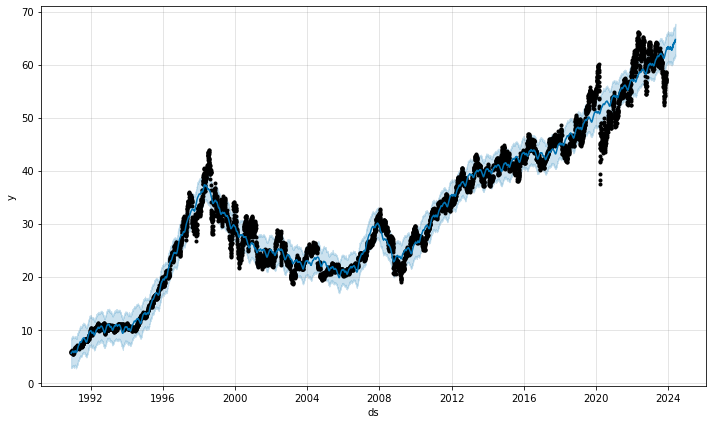

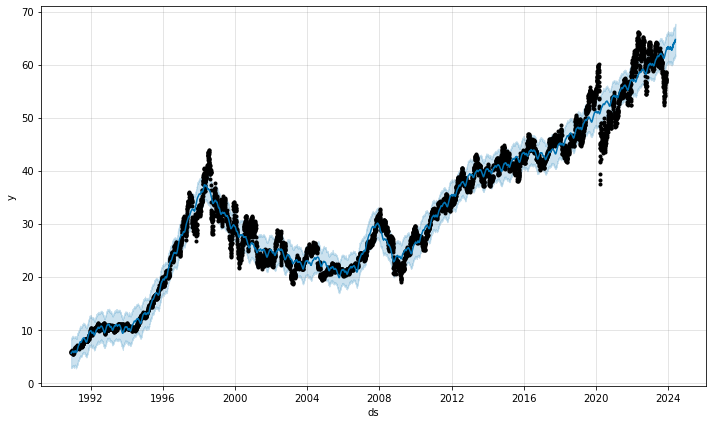

In [55]:
trend_plot = auto_model.plot(six_month_forecast)
trend_plot

In [56]:
from prophet.plot import plot_plotly

trend_plot = plot_plotly(auto_model, six_month_forecast)
trend_plot


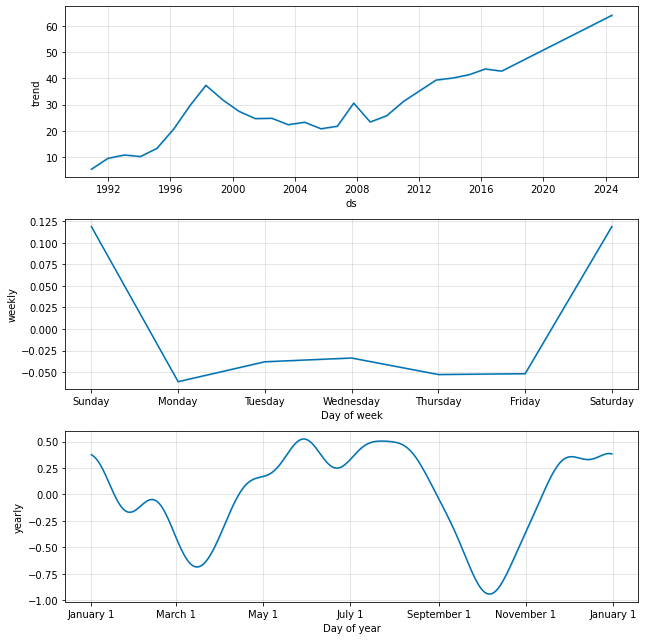

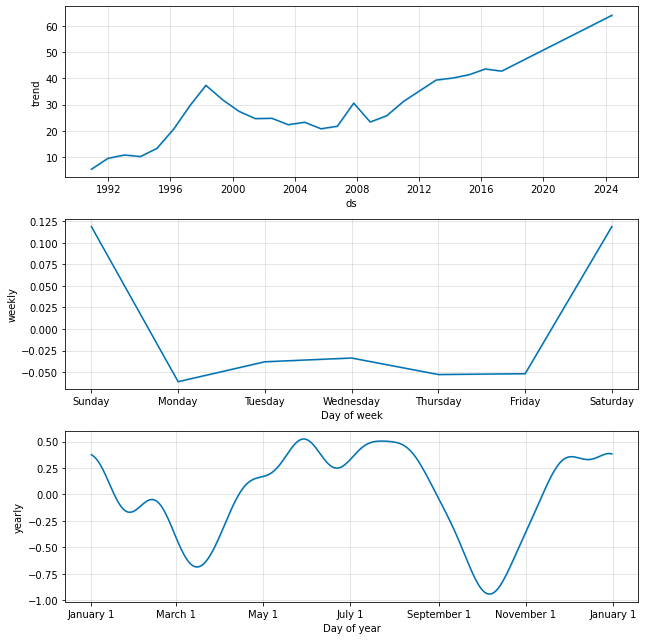

In [58]:
six_month_performance_plot = auto_model.plot_components(six_month_forecast)
six_month_performance_plot

[[<matplotlib.lines.Line2D at 0x1e36ce5a100>],

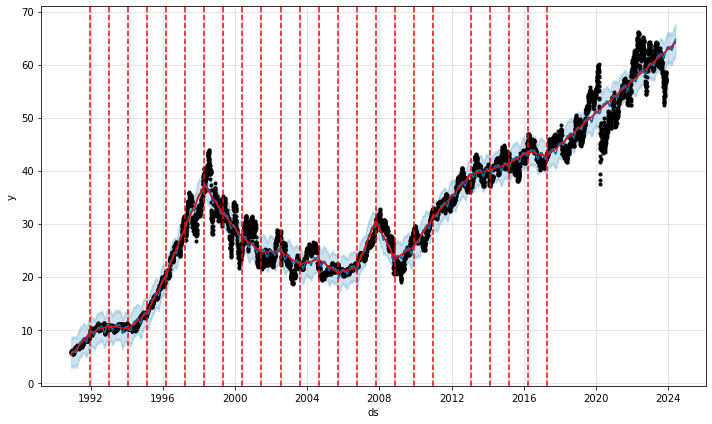

In [59]:
# Trends and seasonality
trend_plot = auto_model.plot(six_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       auto_model, six_month_forecast)
trends_and_seasonality_plot

In [60]:
from prophet.diagnostics import cross_validation
six_month_cv = cross_validation(auto_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/61 [00:00<?, ?it/s]

16:43:39 - cmdstanpy - INFO - Chain [1] start processing
16:43:39 - cmdstanpy - INFO - Chain [1] done processing
16:43:39 - cmdstanpy - INFO - Chain [1] start processing
16:43:40 - cmdstanpy - INFO - Chain [1] done processing
16:43:40 - cmdstanpy - INFO - Chain [1] start processing
16:43:40 - cmdstanpy - INFO - Chain [1] done processing
16:43:41 - cmdstanpy - INFO - Chain [1] start processing
16:43:41 - cmdstanpy - INFO - Chain [1] done processing
16:43:41 - cmdstanpy - INFO - Chain [1] start processing
16:43:42 - cmdstanpy - INFO - Chain [1] done processing
16:43:42 - cmdstanpy - INFO - Chain [1] start processing
16:43:43 - cmdstanpy - INFO - Chain [1] done processing
16:43:43 - cmdstanpy - INFO - Chain [1] start processing
16:43:43 - cmdstanpy - INFO - Chain [1] done processing
16:43:44 - cmdstanpy - INFO - Chain [1] start processing
16:43:44 - cmdstanpy - INFO - Chain [1] done processing
16:43:44 - cmdstanpy - INFO - Chain [1] start processing
16:43:45 - cmdstanpy - INFO - Chain [1]

In [61]:
six_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-05-05,9.769613,9.566932,10.000162,9.812500,1993-05-04
1,1993-05-06,9.795248,9.581244,10.022313,9.718750,1993-05-04
2,1993-05-07,9.804399,9.581705,10.046563,9.687500,1993-05-04
3,1993-05-10,9.884203,9.673027,10.107585,9.781250,1993-05-04
4,1993-05-11,9.885557,9.670036,10.106820,10.031250,1993-05-04
...,...,...,...,...,...,...
15345,2023-11-21,62.616540,59.154545,66.244757,58.029999,2022-11-28
15346,2023-11-22,62.636896,59.422506,66.512368,58.419998,2022-11-28
15347,2023-11-24,62.650314,59.323375,66.213683,58.570000,2022-11-28
15348,2023-11-27,62.672143,59.388994,66.159649,58.459999,2022-11-28


In [62]:
# Performance metrics
from prophet.diagnostics import performance_metrics
six_month_performance_df = performance_metrics(six_month_cv)
six_month_performance_df


,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,8.344762,2.888730,2.252633,0.071284,0.060383,0.070818,0.451648
1,38 days,8.449034,2.906722,2.265322,0.071663,0.059807,0.071264,0.449686
2,39 days,8.590983,2.931038,2.283457,0.072080,0.060383,0.071744,0.448922
3,40 days,8.664594,2.943568,2.292896,0.072174,0.060632,0.071913,0.448891
4,41 days,8.706273,2.950639,2.298149,0.072286,0.061072,0.072059,0.447405
...,...,...,...,...,...,...,...,...
324,361 days,25.801404,5.079508,3.921880,0.128735,0.091685,0.126068,0.780183
325,362 days,25.916471,5.090822,3.931203,0.129245,0.091778,0.126490,0.780394
326,363 days,26.037184,5.102664,3.938288,0.129676,0.092898,0.126868,0.782783
327,364 days,26.230775,5.121599,3.949229,0.130141,0.092898,0.127286,0.785606


#  Twelve month auto forecast

In [63]:
twelve_month_future = auto_model.make_future_dataframe(periods=12*30, freq='D')

In [64]:
twelve_month_forecast = auto_model.predict(twelve_month_future)

In [65]:
twelve_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
8667,2024-11-18,65.655105,61.942900,69.347805,65.552389,63.522556,67.509563
8668,2024-11-19,65.712029,61.915872,69.255668,65.560620,63.500915,67.536365
8669,2024-11-20,65.748822,61.915940,69.356918,65.568852,63.500875,67.563166
8670,2024-11-21,65.760532,61.981211,69.332632,65.577084,63.501796,67.589967
8671,2024-11-22,65.790554,61.862713,69.559776,65.585315,63.502717,67.616768


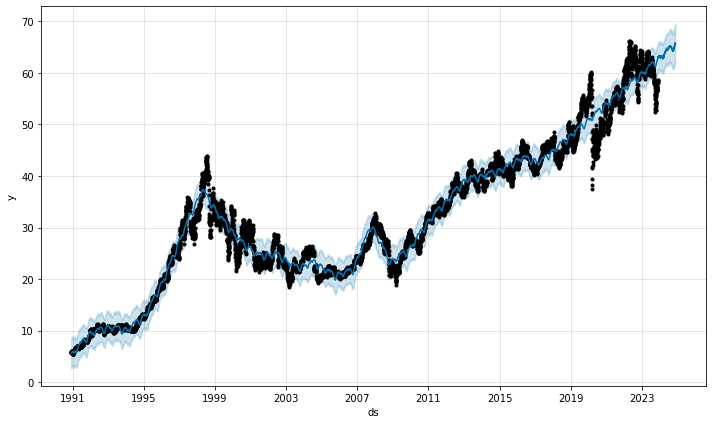

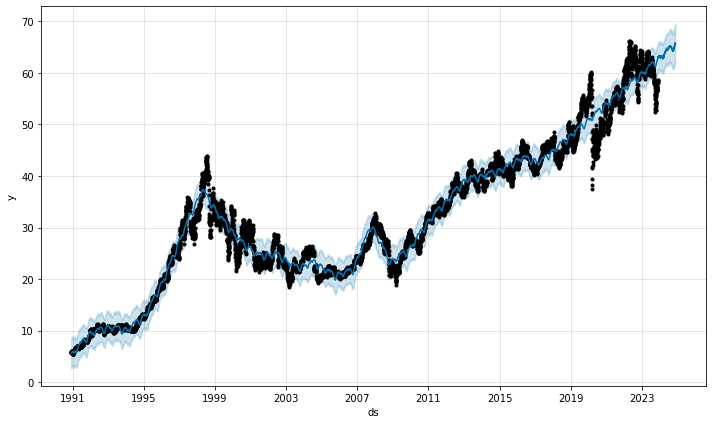

In [66]:
trend_plot = auto_model.plot(twelve_month_forecast)
trend_plot

In [67]:
from prophet.plot import plot_plotly

trend_plot = plot_plotly(auto_model, twelve_month_forecast)
trend_plot


In [163]:
'''
twelve_month_performance_plot = auto_model.plot_components(twelve_month_forecast)
twelve_month_performance_plot
'''

'\ntwelve_month_performance_plot = auto_model.plot_components(twelve_month_forecast)\ntwelve_month_performance_plot\n'

[[<matplotlib.lines.Line2D at 0x1e302adbf70>],

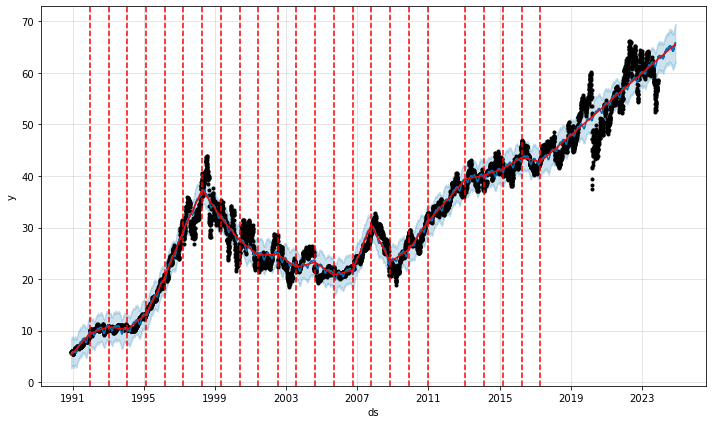

In [69]:
# Trends and seasonality
trend_plot = auto_model.plot(twelve_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       auto_model, twelve_month_forecast)
trends_and_seasonality_plot

In [70]:
from prophet.diagnostics import cross_validation
twelve_month_cv = cross_validation(auto_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/61 [00:00<?, ?it/s]

16:47:05 - cmdstanpy - INFO - Chain [1] start processing
16:47:05 - cmdstanpy - INFO - Chain [1] done processing
16:47:05 - cmdstanpy - INFO - Chain [1] start processing
16:47:05 - cmdstanpy - INFO - Chain [1] done processing
16:47:06 - cmdstanpy - INFO - Chain [1] start processing
16:47:06 - cmdstanpy - INFO - Chain [1] done processing
16:47:07 - cmdstanpy - INFO - Chain [1] start processing
16:47:07 - cmdstanpy - INFO - Chain [1] done processing
16:47:07 - cmdstanpy - INFO - Chain [1] start processing
16:47:08 - cmdstanpy - INFO - Chain [1] done processing
16:47:08 - cmdstanpy - INFO - Chain [1] start processing
16:47:08 - cmdstanpy - INFO - Chain [1] done processing
16:47:09 - cmdstanpy - INFO - Chain [1] start processing
16:47:09 - cmdstanpy - INFO - Chain [1] done processing
16:47:09 - cmdstanpy - INFO - Chain [1] start processing
16:47:10 - cmdstanpy - INFO - Chain [1] done processing
16:47:10 - cmdstanpy - INFO - Chain [1] start processing
16:47:11 - cmdstanpy - INFO - Chain [1]

In [71]:
twelve_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-05-05,9.769613,9.564865,9.992646,9.812500,1993-05-04
1,1993-05-06,9.795248,9.562869,10.009007,9.718750,1993-05-04
2,1993-05-07,9.804399,9.589232,10.031128,9.687500,1993-05-04
3,1993-05-10,9.884203,9.642359,10.099654,9.781250,1993-05-04
4,1993-05-11,9.885557,9.660795,10.112700,10.031250,1993-05-04
...,...,...,...,...,...,...
15345,2023-11-21,62.616540,58.599689,66.126993,58.029999,2022-11-28
15346,2023-11-22,62.636896,58.851141,66.202745,58.419998,2022-11-28
15347,2023-11-24,62.650314,58.874405,66.084459,58.570000,2022-11-28
15348,2023-11-27,62.672143,59.079487,66.386462,58.459999,2022-11-28


In [72]:
# Performance metrics
from prophet.diagnostics import performance_metrics
twelve_month_performance_df = performance_metrics(twelve_month_cv)
twelve_month_performance_df

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,8.344762,2.888730,2.252633,0.071284,0.060383,0.070818,0.458162
1,38 days,8.449034,2.906722,2.265322,0.071663,0.059807,0.071264,0.456201
2,39 days,8.590983,2.931038,2.283457,0.072080,0.060383,0.071744,0.456088
3,40 days,8.664594,2.943568,2.292896,0.072174,0.060632,0.071913,0.454754
4,41 days,8.706273,2.950639,2.298149,0.072286,0.061072,0.072059,0.452617
...,...,...,...,...,...,...,...,...
324,361 days,25.801404,5.079508,3.921880,0.128735,0.091685,0.126068,0.763457
325,362 days,25.916471,5.090822,3.931203,0.129245,0.091778,0.126490,0.764914
326,363 days,26.037184,5.102664,3.938288,0.129676,0.092898,0.126868,0.765705
327,364 days,26.230775,5.121599,3.949229,0.130141,0.092898,0.127286,0.766682


#  Eighteen month auto forecast

In [73]:
eighteen_month_future = auto_model.make_future_dataframe(periods=18*30, freq='D')

In [74]:
eighteen_month_forecast = auto_model.predict(eighteen_month_future)

In [75]:
eighteen_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
8847,2025-05-17,67.515078,62.246713,72.165867,67.034092,62.759633,70.925918
8848,2025-05-18,67.543209,62.653111,72.035189,67.042323,62.755490,70.951690
8849,2025-05-19,67.391270,62.104555,72.438973,67.050555,62.752057,70.973111
8850,2025-05-20,67.441795,62.684443,72.316805,67.058787,62.748624,70.994318
8851,2025-05-21,67.472790,62.213772,72.535389,67.067018,62.748669,71.014062


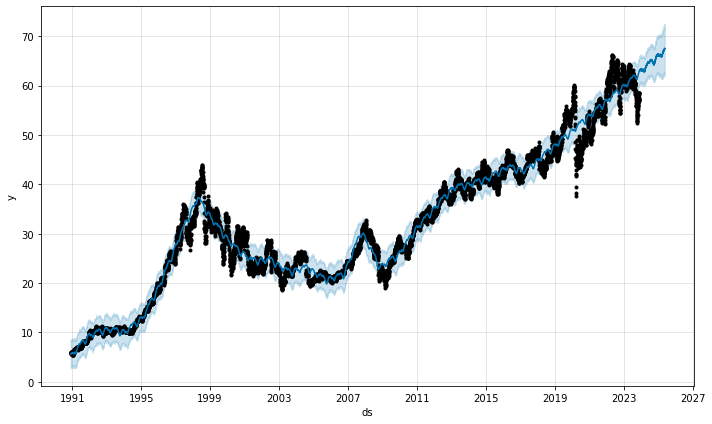

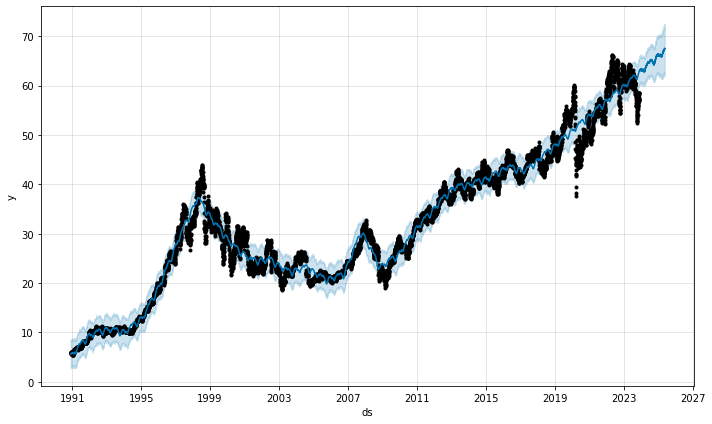

In [76]:
trend_plot = auto_model.plot(eighteen_month_forecast)
trend_plot

In [77]:
from prophet.plot import plot_plotly
trend_plot = plot_plotly(auto_model, eighteen_month_forecast)
trend_plot


In [162]:
'''
eighteen_month_performance_plot = auto_model.plot_components(eighteen_month_forecast)
eighteen_month_performance_plot
'''

'\neighteen_month_performance_plot = auto_model.plot_components(eighteen_month_forecast)\neighteen_month_performance_plot\n'

[[<matplotlib.lines.Line2D at 0x1e304820580>],

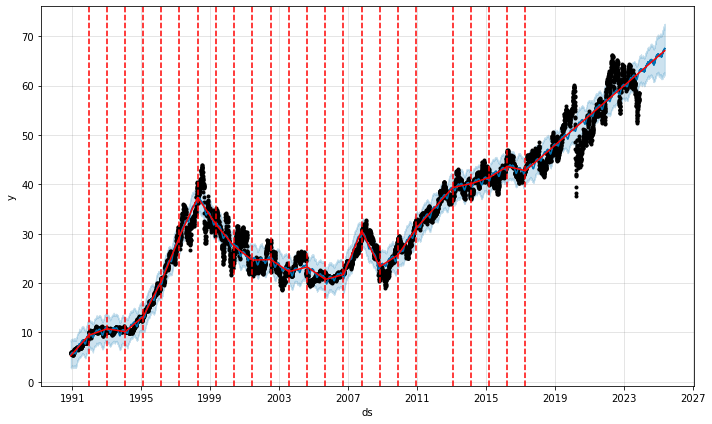

In [79]:
# Trends and seasonality
trend_plot = auto_model.plot(eighteen_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       auto_model, eighteen_month_forecast)
trends_and_seasonality_plot

In [80]:
from prophet.diagnostics import cross_validation
eighteen_month_cv = cross_validation(auto_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/61 [00:00<?, ?it/s]

16:49:51 - cmdstanpy - INFO - Chain [1] start processing
16:49:51 - cmdstanpy - INFO - Chain [1] done processing
16:49:51 - cmdstanpy - INFO - Chain [1] start processing
16:49:51 - cmdstanpy - INFO - Chain [1] done processing
16:49:52 - cmdstanpy - INFO - Chain [1] start processing
16:49:52 - cmdstanpy - INFO - Chain [1] done processing
16:49:52 - cmdstanpy - INFO - Chain [1] start processing
16:49:53 - cmdstanpy - INFO - Chain [1] done processing
16:49:53 - cmdstanpy - INFO - Chain [1] start processing
16:49:53 - cmdstanpy - INFO - Chain [1] done processing
16:49:54 - cmdstanpy - INFO - Chain [1] start processing
16:49:54 - cmdstanpy - INFO - Chain [1] done processing
16:49:54 - cmdstanpy - INFO - Chain [1] start processing
16:49:55 - cmdstanpy - INFO - Chain [1] done processing
16:49:55 - cmdstanpy - INFO - Chain [1] start processing
16:49:56 - cmdstanpy - INFO - Chain [1] done processing
16:49:56 - cmdstanpy - INFO - Chain [1] start processing
16:49:56 - cmdstanpy - INFO - Chain [1]

In [81]:
eighteen_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-05-05,9.769613,9.549918,9.983078,9.812500,1993-05-04
1,1993-05-06,9.795248,9.568190,10.037337,9.718750,1993-05-04
2,1993-05-07,9.804399,9.568361,10.026471,9.687500,1993-05-04
3,1993-05-10,9.884203,9.643636,10.133718,9.781250,1993-05-04
4,1993-05-11,9.885557,9.665762,10.118284,10.031250,1993-05-04
...,...,...,...,...,...,...
15345,2023-11-21,62.616540,58.961653,66.461681,58.029999,2022-11-28
15346,2023-11-22,62.636896,59.011198,66.351526,58.419998,2022-11-28
15347,2023-11-24,62.650314,58.948550,66.263067,58.570000,2022-11-28
15348,2023-11-27,62.672143,59.350239,66.395289,58.459999,2022-11-28


In [82]:
# Performance metrics
from prophet.diagnostics import performance_metrics
eighteen_month_performance_df = performance_metrics(eighteen_month_cv)
eighteen_month_performance_df

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,8.344762,2.888730,2.252633,0.071284,0.060383,0.070818,0.452951
1,38 days,8.449034,2.906722,2.265322,0.071663,0.059807,0.071264,0.450989
2,39 days,8.590983,2.931038,2.283457,0.072080,0.060383,0.071744,0.450535
3,40 days,8.664594,2.943568,2.292896,0.072174,0.060632,0.071913,0.448891
4,41 days,8.706273,2.950639,2.298149,0.072286,0.061072,0.072059,0.447405
...,...,...,...,...,...,...,...,...
324,361 days,25.801404,5.079508,3.921880,0.128735,0.091685,0.126068,0.754125
325,362 days,25.916471,5.090822,3.931203,0.129245,0.091778,0.126490,0.754490
326,363 days,26.037184,5.102664,3.938288,0.129676,0.092898,0.126868,0.757376
327,364 days,26.230775,5.121599,3.949229,0.130141,0.092898,0.127286,0.760012


#  Predict KO 6, 12, 18 months with LSTM model

In [83]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

In [84]:
coke_stock_df.set_index('ds', inplace=True)
coke_stock_df.head(), coke_df.tail()

(                   y
 ds                  
 1990-11-29  5.593750
 1990-11-30  5.781250
 1990-12-03  5.843750
 1990-12-04  5.859375
 1990-12-05  5.937500,
             Date      Close
 8307  2023-11-21  58.029999
 8308  2023-11-22  58.419998
 8309  2023-11-24  58.570000
 8310  2023-11-27  58.459999
 8311  2023-11-28  58.580002)

In [85]:
stock_data = coke_stock_df['y'].values.reshape(-1, 1)

In [86]:
# Normalize the data using Min-Max scaling
scaler = MinMaxScaler()
stock_data_scaled = scaler.fit_transform(stock_data)

In [87]:
# Function to create time series data with specified lookback
def create_time_series_data(data, lookback):
    X, y = [], []
    for i in range(len(data) - lookback):
        X.append(data[i:(i + lookback), 0])
        y.append(data[i + lookback, 0])
    return np.array(X), np.array(y)

In [88]:
# Set the lookback period (relatively arbitrary; can experiment with different values)
lookback = 60

In [89]:
X, y = create_time_series_data(stock_data_scaled, lookback)

In [90]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=122, shuffle=False)

In [91]:
# Reshape the data for LSTM input shape (samples, time steps, features)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

In [92]:
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
model.add(LSTM(units=50, return_sequences=True))
model.add(LSTM(units=50))
model.add(Dense(units=1))
model.compile(optimizer='adam', loss='mean_squared_error')

In [93]:
model.fit(X_train, y_train, epochs=50, batch_size=32)

Epoch 1/50
194/194 [==============================] - 16s 54ms/step - loss: 0.0032
Epoch 2/50
194/194 [==============================] - 11s 55ms/step - loss: 3.0883e-04
Epoch 3/50
194/194 [==============================] - 10s 52ms/step - loss: 2.9656e-04
Epoch 4/50
194/194 [==============================] - 10s 53ms/step - loss: 2.4475e-04
Epoch 5/50
194/194 [==============================] - 11s 55ms/step - loss: 2.1394e-04
Epoch 6/50
194/194 [==============================] - 10s 54ms/step - loss: 1.8798e-04
Epoch 7/50
194/194 [==============================] - 10s 53ms/step - loss: 1.4982e-04
Epoch 8/50
194/194 [==============================] - 10s 53ms/step - loss: 1.4366e-04
Epoch 9/50
194/194 [==============================] - 10s 52ms/step - loss: 1.4487e-04
Epoch 10/50
194/194 [==============================] - 10s 52ms/step - loss: 1.2934e-04
Epoch 11/50
194/194 [==============================] - 10s 52ms/step - loss: 1.1573e-04
Epoch 12/50
194/194 [========================

In [94]:
loss = model.evaluate(X_test, y_test)
print(f'Test Loss: {loss}')


65/65 [==============================] - 2s 22ms/step - loss: 2.7735e-04
Test Loss: 0.0002773518499452621


In [95]:
# Forecast 6, 12, and 18 months into the future
future_months = [6, 12, 18]
for months in future_months:
    # Assuming the last available data is used to make predictions
    last_data_point = stock_data_scaled[-lookback:]
    future_dates = pd.date_range(start=coke_stock_df.index[-1], periods=months + 1, freq='M')[1:]

    for _ in range(months):
        # Reshape the data for prediction
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)


1/1 [==============================] - 0s 24ms/step


In [96]:
# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(last_data_point[-months:].reshape(-1, 1))
predicted_prices

array([[57.44269598],
       [56.47137186],
       [55.85067938],
       [55.25155827],
       [54.74623577],
       [54.29543454],
       [53.89424129],
       [53.53216584],
       [53.20258341],
       [52.89979386],
       [52.61935164],
       [52.35761983],
       [52.11173386],
       [51.87937667],
       [51.65869898],
       [51.44819236],
       [51.24676537],
       [51.05349698]])

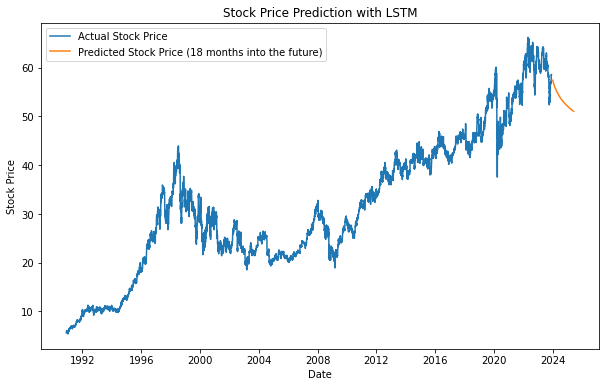

In [97]:
# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(coke_stock_df.index, coke_stock_df['y'], label='Actual Stock Price')
plt.plot(future_dates, predicted_prices, label=f'Predicted Stock Price ({months} months into the future)')
plt.title('Stock Price Prediction with LSTM')
plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.legend()

In [98]:
import plotly.graph_objects as go

In [99]:
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions
# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)


# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()

1/1 [==============================] - 0s 25ms/step


In [100]:
coke_stock_df.tail()

,y
ds,
2023-11-21,58.029999
2023-11-22,58.419998
2023-11-24,58.570000
2023-11-27,58.459999
2023-11-28,58.580002


In [101]:
import plotly.graph_objects as go

# Function to make predictions for future months
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions

# Make predictions for 18 months into the future
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)

# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(np.array(predictions).reshape(-1, 1))

# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
last_date = coke_stock_df.index[-1]
future_dates = pd.date_range(start=last_date, periods=future_months + 1, freq='MS')[1:].tolist()
fig.add_trace(go.Scatter(x=future_dates, y=predicted_prices.flatten(), mode='lines', name='Predicted Stock Price'))

# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()


1/1 [==============================] - 0s 26ms/step


#  Try lookback of 180 in LSTM

In [102]:
# Set the lookback period (relatively arbitrary; can experiment with different values)
lookback = 180

In [103]:
X, y = create_time_series_data(stock_data_scaled, lookback)

In [104]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=122, shuffle=False)

In [105]:
# Reshape the data for LSTM input shape (samples, time steps, features)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

In [106]:
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
model.add(LSTM(units=50, return_sequences=True))
model.add(LSTM(units=50))
model.add(Dense(units=1))
model.compile(optimizer='adam', loss='mean_squared_error')

In [107]:
model.fit(X_train, y_train, epochs=50, batch_size=32)

Epoch 1/50
191/191 [==============================] - 31s 148ms/step - loss: 0.0045
Epoch 2/50
191/191 [==============================] - 28s 149ms/step - loss: 3.2624e-04
Epoch 3/50
191/191 [==============================] - 29s 150ms/step - loss: 2.8995e-04
Epoch 4/50
191/191 [==============================] - 28s 145ms/step - loss: 2.5502e-04
Epoch 5/50
191/191 [==============================] - 29s 150ms/step - loss: 2.7067e-04
Epoch 6/50
191/191 [==============================] - 28s 147ms/step - loss: 2.1802e-04
Epoch 7/50
191/191 [==============================] - 28s 148ms/step - loss: 1.8238e-04
Epoch 8/50
191/191 [==============================] - 28s 149ms/step - loss: 1.6917e-04
Epoch 9/50
191/191 [==============================] - 29s 149ms/step - loss: 1.6078e-04
Epoch 10/50
191/191 [==============================] - 29s 151ms/step - loss: 1.4265e-04
Epoch 11/50
191/191 [==============================] - 29s 152ms/step - loss: 1.2867e-04
Epoch 12/50
191/191 [=============

In [108]:
loss = model.evaluate(X_test, y_test)
print(f'Test Loss: {loss}')

64/64 [==============================] - 4s 51ms/step - loss: 1.4382e-04
Test Loss: 0.0001438230974599719


In [109]:
# Forecast 6, 12, and 18 months into the future
future_months = [6, 12, 18]
for months in future_months:
    # Assuming the last available data is used to make predictions
    last_data_point = stock_data_scaled[-lookback:]
    future_dates = pd.date_range(start=coke_stock_df.index[-1], periods=months + 1, freq='M')[1:]

    for _ in range(months):
        # Reshape the data for prediction
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)


1/1 [==============================] - 0s 28ms/step


In [110]:
# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(last_data_point[-months:].reshape(-1, 1))
predicted_prices

array([[58.38028334],
       [58.07611589],
       [57.84672843],
       [57.67192751],
       [57.51369038],
       [57.36802114],
       [57.23663489],
       [57.11768237],
       [57.00853831],
       [56.90736793],
       [56.81311968],
       [56.72513361],
       [56.64295285],
       [56.56633445],
       [56.49501732],
       [56.42880205],
       [56.36742755],
       [56.3106799 ]])

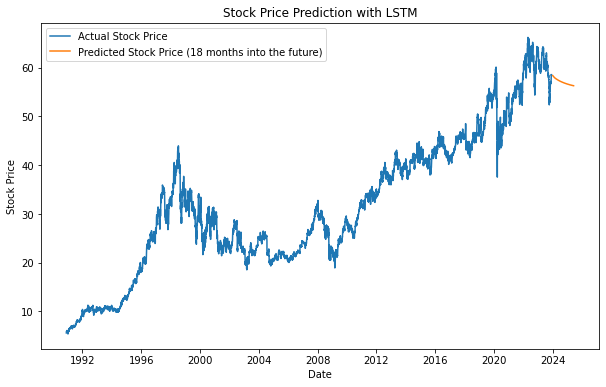

In [111]:
# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(coke_stock_df.index, coke_stock_df['y'], label='Actual Stock Price')
plt.plot(future_dates, predicted_prices, label=f'Predicted Stock Price ({months} months into the future)')
plt.title('Stock Price Prediction with LSTM')
plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.legend()

In [112]:
import plotly.graph_objects as go

In [113]:
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions
# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)


# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()

1/1 [==============================] - 0s 40ms/step


In [114]:
import plotly.graph_objects as go

# Function to make predictions for future months
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions

# Make predictions for 18 months into the future
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)

# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(np.array(predictions).reshape(-1, 1))

# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
last_date = coke_stock_df.index[-1]
future_dates = pd.date_range(start=last_date, periods=future_months + 1, freq='MS')[1:].tolist()
fig.add_trace(go.Scatter(x=future_dates, y=predicted_prices.flatten(), mode='lines', name='Predicted Stock Price'))

# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()


1/1 [==============================] - 0s 26ms/step


#  Try lookback of 365

In [115]:
# Set the lookback period (relatively arbitrary; can experiment with different values)
lookback = 365

In [116]:
X, y = create_time_series_data(stock_data_scaled, lookback)

In [117]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=122, shuffle=False)

In [118]:
# Reshape the data for LSTM input shape (samples, time steps, features)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

In [119]:
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
model.add(LSTM(units=50, return_sequences=True))
model.add(LSTM(units=50))
model.add(Dense(units=1))
model.compile(optimizer='adam', loss='mean_squared_error')

In [120]:
model.fit(X_train, y_train, epochs=50, batch_size=32)

Epoch 1/50
187/187 [==============================] - 61s 309ms/step - loss: 0.0043
Epoch 2/50
187/187 [==============================] - 60s 320ms/step - loss: 3.3556e-04
Epoch 3/50
187/187 [==============================] - 57s 305ms/step - loss: 3.1164e-04
Epoch 4/50
187/187 [==============================] - 55s 292ms/step - loss: 2.7328e-04
Epoch 5/50
187/187 [==============================] - 55s 292ms/step - loss: 2.4744e-04
Epoch 6/50
187/187 [==============================] - 56s 302ms/step - loss: 2.0072e-04
Epoch 7/50
187/187 [==============================] - 56s 299ms/step - loss: 1.8658e-04
Epoch 8/50
187/187 [==============================] - 55s 294ms/step - loss: 1.9184e-04
Epoch 9/50
187/187 [==============================] - 56s 301ms/step - loss: 1.5330e-04
Epoch 10/50
187/187 [==============================] - 54s 287ms/step - loss: 1.3671e-04
Epoch 11/50
187/187 [==============================] - 55s 296ms/step - loss: 1.2233e-04
Epoch 12/50
187/187 [=============

In [121]:
loss = model.evaluate(X_test, y_test)
print(f'Test Loss: {loss}')

63/63 [==============================] - 7s 103ms/step - loss: 6.0422e-04
Test Loss: 0.0006042158929631114


In [122]:
# Forecast 6, 12, and 18 months into the future
future_months = [6, 12, 18]
for months in future_months:
    # Assuming the last available data is used to make predictions
    last_data_point = stock_data_scaled[-lookback:]
    future_dates = pd.date_range(start=coke_stock_df.index[-1], periods=months + 1, freq='M')[1:]

    for _ in range(months):
        # Reshape the data for prediction
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)

1/1 [==============================] - 0s 52ms/step


In [123]:
# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(last_data_point[-months:].reshape(-1, 1))
predicted_prices

array([[56.65974508],
       [54.91640623],
       [53.57817314],
       [52.49202295],
       [51.60768773],
       [50.85257764],
       [50.1831837 ],
       [49.57648052],
       [49.02105328],
       [48.51018656],
       [48.03849204],
       [47.60083524],
       [47.19221221],
       [46.80807951],
       [46.44446661],
       [46.09806295],
       [45.76623237],
       [45.44686452]])

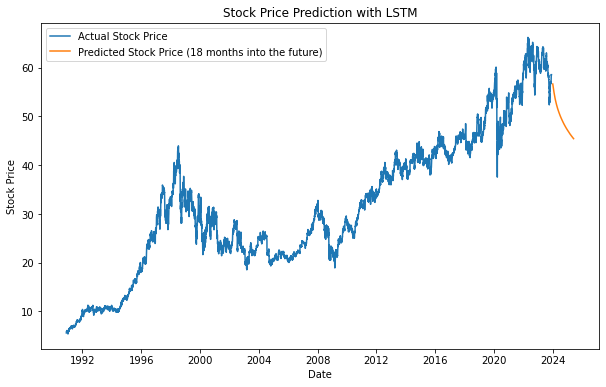

In [124]:
# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(coke_stock_df.index, coke_stock_df['y'], label='Actual Stock Price')
plt.plot(future_dates, predicted_prices, label=f'Predicted Stock Price ({months} months into the future)')
plt.title('Stock Price Prediction with LSTM')
plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.legend()

In [125]:
import plotly.graph_objects as go

In [126]:
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions
# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)


# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()

1/1 [==============================] - 0s 49ms/step


In [127]:
import plotly.graph_objects as go

# Function to make predictions for future months
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions

# Make predictions for 18 months into the future
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)

# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(np.array(predictions).reshape(-1, 1))

# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
last_date = coke_stock_df.index[-1]
future_dates = pd.date_range(start=last_date, periods=future_months + 1, freq='MS')[1:].tolist()
fig.add_trace(go.Scatter(x=future_dates, y=predicted_prices.flatten(), mode='lines', name='Predicted Stock Price'))

# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()


1/1 [==============================] - 0s 66ms/step


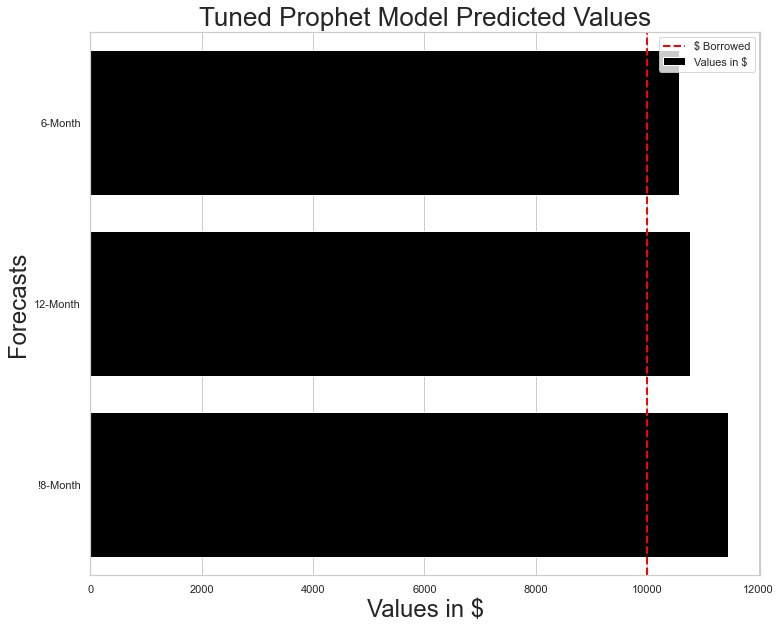

In [128]:
import seaborn as sns
import matplotlib.pyplot as plt

# Data
values = [10577.92, 10760.09, 11454.43]
threshold = 10000

# Create a bar graph
sns.set(style="whitegrid")
plt.figure(figsize=(12, 10))

# Plot bars
sns.barplot(x=values, y=['6-Month', '12-Month', '!8-Month'], color='black', label='Values in $')

# Plot threshold line
plt.axvline(x=threshold, color='red', linestyle='--', linewidth=2, label='$ Borrowed')

# Customize the plot
plt.title('Tuned Prophet Model Predicted Values', fontsize=26)
plt.xlabel('Values in $', fontsize=24)
plt.ylabel('Forecasts', fontsize=24)
plt.legend()

# Show the plot
plt.show()


#  Try LSTM on First Half of Dataset

In [129]:
first_half_coke_df = coke_df.head(len(coke_df) // 2)
first_half_coke_df.shape

(4156, 2)

In [130]:
first_half_coke_df.tail()

,Date,Close
4151,2007-05-21,25.955000
4152,2007-05-22,25.740000
4153,2007-05-23,25.665001
4154,2007-05-24,25.620001
4155,2007-05-25,25.945000


In [131]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

In [132]:
coke_stock_df = pd.DataFrame()
coke_stock_df['ds'] = pd.to_datetime(first_half_coke_df['Date'])
coke_stock_df['y'] = coke_df['Close']
coke_stock_df.head(), coke_df.tail()

(          ds         y
 0 1990-11-29  5.593750
 1 1990-11-30  5.781250
 2 1990-12-03  5.843750
 3 1990-12-04  5.859375
 4 1990-12-05  5.937500,
             Date      Close
 8307  2023-11-21  58.029999
 8308  2023-11-22  58.419998
 8309  2023-11-24  58.570000
 8310  2023-11-27  58.459999
 8311  2023-11-28  58.580002)

In [133]:
coke_stock_df.set_index('ds', inplace=True)
coke_stock_df.head(), coke_stock_df.tail()

(                   y
 ds                  
 1990-11-29  5.593750
 1990-11-30  5.781250
 1990-12-03  5.843750
 1990-12-04  5.859375
 1990-12-05  5.937500,
                     y
 ds                   
 2007-05-21  25.955000
 2007-05-22  25.740000
 2007-05-23  25.665001
 2007-05-24  25.620001
 2007-05-25  25.945000)

In [134]:
stock_data = coke_stock_df['y'].values.reshape(-1, 1)

In [135]:
# Normalize the data using Min-Max scaling
scaler = MinMaxScaler()
stock_data_scaled = scaler.fit_transform(stock_data)

In [136]:
# Function to create time series data with specified lookback
def create_time_series_data(data, lookback):
    X, y = [], []
    for i in range(len(data) - lookback):
        X.append(data[i:(i + lookback), 0])
        y.append(data[i + lookback, 0])
    return np.array(X), np.array(y)

In [137]:
# Set the lookback period (relatively arbitrary; can experiment with different values)
lookback = 365

In [138]:
X, y = create_time_series_data(stock_data_scaled, lookback)

In [139]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=122, shuffle=False)

In [140]:
# Reshape the data for LSTM input shape (samples, time steps, features)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

In [141]:
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
model.add(LSTM(units=50, return_sequences=True))
model.add(LSTM(units=50))
model.add(Dense(units=1))
model.compile(optimizer='adam', loss='mean_squared_error')

In [142]:
model.fit(X_train, y_train, epochs=50, batch_size=32)

Epoch 1/50
89/89 [==============================] - 30s 300ms/step - loss: 0.0143
Epoch 2/50
89/89 [==============================] - 27s 302ms/step - loss: 0.0011
Epoch 3/50
89/89 [==============================] - 27s 301ms/step - loss: 9.4320e-04
Epoch 4/50
89/89 [==============================] - 27s 303ms/step - loss: 8.7963e-04
Epoch 5/50
89/89 [==============================] - 28s 309ms/step - loss: 8.4771e-04
Epoch 6/50
89/89 [==============================] - 27s 300ms/step - loss: 7.9377e-04
Epoch 7/50
89/89 [==============================] - 27s 305ms/step - loss: 7.2084e-04
Epoch 8/50
89/89 [==============================] - 27s 303ms/step - loss: 7.4336e-04
Epoch 9/50
89/89 [==============================] - 27s 306ms/step - loss: 5.9792e-04
Epoch 10/50
89/89 [==============================] - 25s 284ms/step - loss: 5.8507e-04
Epoch 11/50
89/89 [==============================] - 26s 296ms/step - loss: 6.0000e-04
Epoch 12/50
89/89 [==============================] - 27s 308

In [143]:
loss = model.evaluate(X_test, y_test)
print(f'Test Loss: {loss}')

30/30 [==============================] - 4s 100ms/step - loss: 2.8324e-05
Test Loss: 2.83235713141039e-05


In [144]:
# Forecast 6, 12, and 18 months into the future
future_months = [6, 12, 18]
for months in future_months:
    # Assuming the last available data is used to make predictions
    last_data_point = stock_data_scaled[-lookback:]
    future_dates = pd.date_range(start=coke_stock_df.index[-1], periods=months + 1, freq='M')[1:]

    for _ in range(months):
        # Reshape the data for prediction
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)

1/1 [==============================] - 0s 38ms/step


In [145]:
# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(last_data_point[-months:].reshape(-1, 1))
predicted_prices

array([[25.8874256 ],
       [25.89258992],
       [25.8792915 ],
       [25.86694774],
       [25.85558392],
       [25.84598679],
       [25.83838638],
       [25.83252735],
       [25.82793352],
       [25.82414021],
       [25.82073567],
       [25.81745535],
       [25.81412672],
       [25.81067386],
       [25.80706689],
       [25.80331499],
       [25.79943657],
       [25.79545234]])

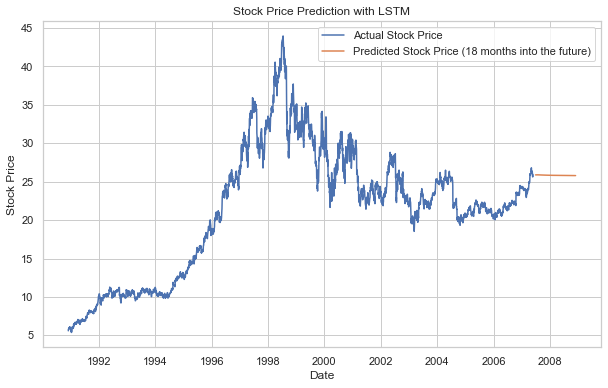

In [146]:
# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(coke_stock_df.index, coke_stock_df['y'], label='Actual Stock Price')
plt.plot(future_dates, predicted_prices, label=f'Predicted Stock Price ({months} months into the future)')
plt.title('Stock Price Prediction with LSTM')
plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.legend()

In [147]:
import plotly.graph_objects as go

In [148]:
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions
# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)


# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()

1/1 [==============================] - 0s 50ms/step


In [149]:
import plotly.graph_objects as go

# Function to make predictions for future months
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions

# Make predictions for 18 months into the future
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)

# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(np.array(predictions).reshape(-1, 1))

# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
last_date = coke_stock_df.index[-1]
future_dates = pd.date_range(start=last_date, periods=future_months + 1, freq='MS')[1:].tolist()
fig.add_trace(go.Scatter(x=future_dates, y=predicted_prices.flatten(), mode='lines', name='Predicted Stock Price'))

# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()

1/1 [==============================] - 0s 49ms/step


# Try FBProphet on first half of data

In [150]:
coke_stock_df = pd.DataFrame()
coke_stock_df['ds'] = pd.to_datetime(first_half_coke_df['Date'])
coke_stock_df['y'] = coke_df['Close']
coke_stock_df.head(), coke_stock_df.tail()

(          ds         y
 0 1990-11-29  5.593750
 1 1990-11-30  5.781250
 2 1990-12-03  5.843750
 3 1990-12-04  5.859375
 4 1990-12-05  5.937500,
              ds          y
 4151 2007-05-21  25.955000
 4152 2007-05-22  25.740000
 4153 2007-05-23  25.665001
 4154 2007-05-24  25.620001
 4155 2007-05-25  25.945000)

In [151]:
# Initialize model
prophet_model = Prophet(interval_width=0.95)
prophet_model.fit(coke_stock_df)

18:53:19 - cmdstanpy - INFO - Chain [1] start processing
18:53:20 - cmdstanpy - INFO - Chain [1] done processing


In [152]:
eighteen_month_future = prophet_model.make_future_dataframe(periods=18*30, freq='D')

In [153]:
eighteen_month_forecast = prophet_model.predict(eighteen_month_future)

In [154]:
eighteen_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
4691,2008-11-11,22.395095,13.879507,30.853199,22.528641,13.822990,30.294675
4692,2008-11-12,22.435089,13.856744,30.731086,22.528714,13.800340,30.317536
4693,2008-11-13,22.442465,13.672901,31.038836,22.528787,13.777691,30.340398
4694,2008-11-14,22.460801,13.492380,31.410539,22.528860,13.755042,30.363259
4695,2008-11-15,22.403815,13.595030,31.206999,22.528933,13.732392,30.386120


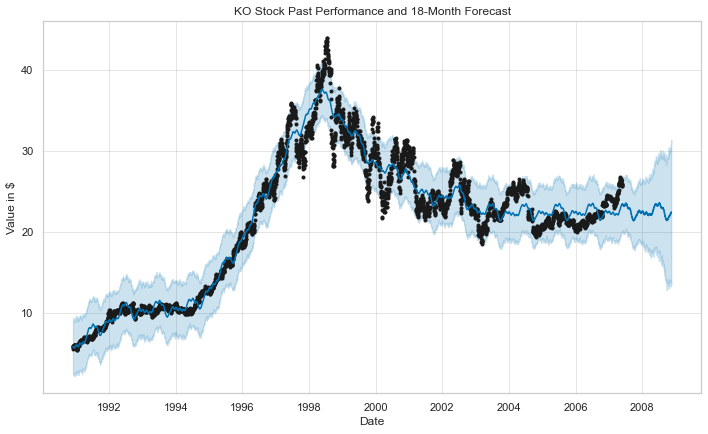

In [155]:
import matplotlib.pyplot as plt
trend_plot = prophet_model.plot(eighteen_month_forecast)
plt.title('KO Stock Past Performance and 18-Month Forecast')
plt.xlabel('Date')
plt.ylabel('Value in $')

trend_plot.show()

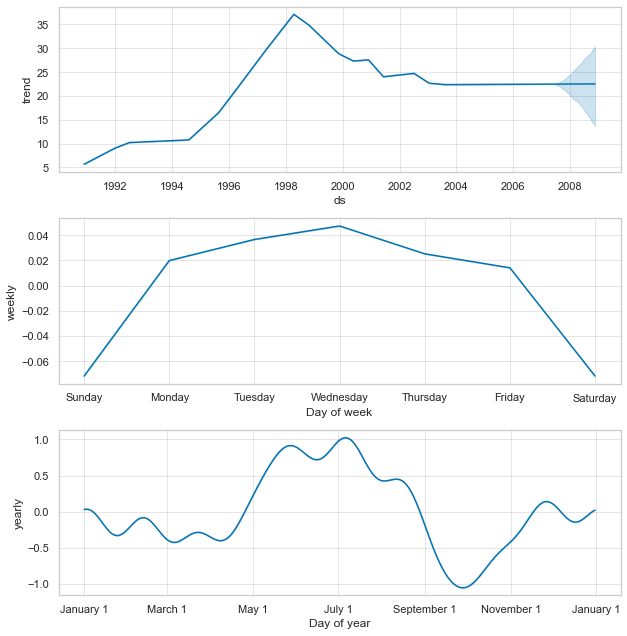

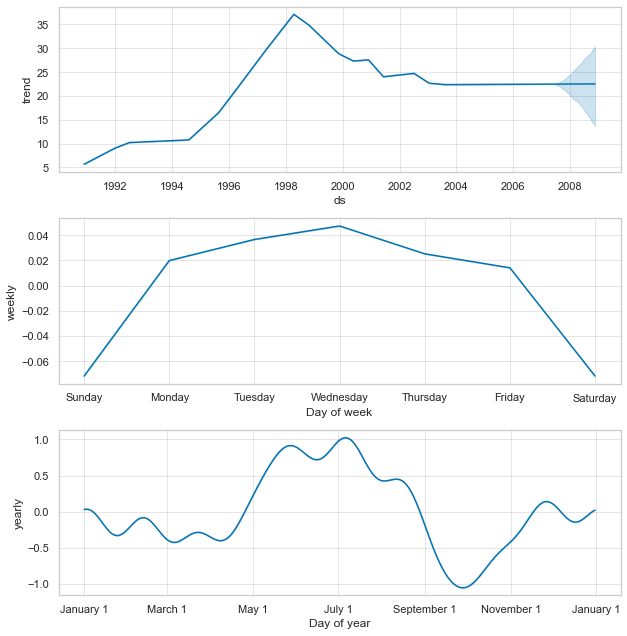

In [156]:
eighteen_month_performance_plot = prophet_model.plot_components(eighteen_month_forecast)
eighteen_month_performance_plot

[[<matplotlib.lines.Line2D at 0x1e32b2c0790>],

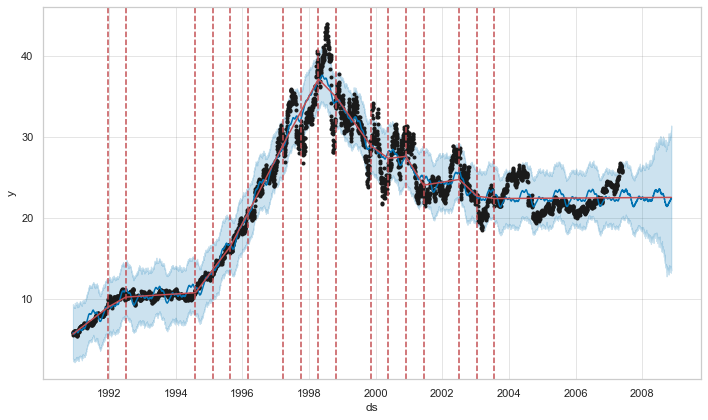

In [157]:
# Trends and seasonality
trend_plot = prophet_model.plot(eighteen_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       prophet_model, eighteen_month_forecast)
trends_and_seasonality_plot

In [158]:
from prophet.diagnostics import cross_validation
eighteen_month_cv = cross_validation(prophet_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/28 [00:00<?, ?it/s]

18:53:32 - cmdstanpy - INFO - Chain [1] start processing
18:53:32 - cmdstanpy - INFO - Chain [1] done processing
18:53:32 - cmdstanpy - INFO - Chain [1] start processing
18:53:32 - cmdstanpy - INFO - Chain [1] done processing
18:53:32 - cmdstanpy - INFO - Chain [1] start processing
18:53:32 - cmdstanpy - INFO - Chain [1] done processing
18:53:33 - cmdstanpy - INFO - Chain [1] start processing
18:53:33 - cmdstanpy - INFO - Chain [1] done processing
18:53:33 - cmdstanpy - INFO - Chain [1] start processing
18:53:33 - cmdstanpy - INFO - Chain [1] done processing
18:53:34 - cmdstanpy - INFO - Chain [1] start processing
18:53:34 - cmdstanpy - INFO - Chain [1] done processing
18:53:34 - cmdstanpy - INFO - Chain [1] start processing
18:53:34 - cmdstanpy - INFO - Chain [1] done processing
18:53:34 - cmdstanpy - INFO - Chain [1] start processing
18:53:35 - cmdstanpy - INFO - Chain [1] done processing
18:53:35 - cmdstanpy - INFO - Chain [1] start processing
18:53:35 - cmdstanpy - INFO - Chain [1]

In [159]:
eighteen_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-02-03,10.504240,10.095407,10.950301,10.468750,1993-02-02
1,1993-02-04,10.548787,10.112059,10.976111,10.437500,1993-02-02
2,1993-02-05,10.574330,10.176030,10.972551,10.312500,1993-02-02
3,1993-02-08,10.651850,10.243591,11.054718,10.281250,1993-02-02
4,1993-02-09,10.651619,10.232832,11.068698,10.187500,1993-02-02
...,...,...,...,...,...,...
7046,2007-05-21,21.250467,14.968466,27.105206,25.955000,2006-05-25
7047,2007-05-22,21.291943,14.824338,27.590157,25.740000,2006-05-25
7048,2007-05-23,21.331205,15.222133,28.069648,25.665001,2006-05-25
7049,2007-05-24,21.326857,15.264647,27.805081,25.620001,2006-05-25


In [160]:
# Performance metrics
from prophet.diagnostics import performance_metrics
eighteen_month_performance_df = performance_metrics(eighteen_month_cv)
eighteen_month_performance_df

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,5.520713,2.349620,1.717134,0.066828,0.052470,0.066787,0.631206
1,38 days,5.658932,2.378851,1.737499,0.067624,0.053163,0.067595,0.627234
2,39 days,5.791776,2.406611,1.756543,0.068364,0.053453,0.068329,0.622396
3,40 days,5.953904,2.440062,1.785454,0.069563,0.054427,0.069471,0.613239
4,41 days,5.993637,2.448191,1.787598,0.069859,0.054974,0.069635,0.611631
...,...,...,...,...,...,...,...,...
324,361 days,21.980830,4.688372,3.413700,0.133838,0.110875,0.135587,0.708772
325,362 days,21.993773,4.689752,3.412569,0.133997,0.110875,0.135779,0.713759
326,363 days,22.059310,4.696734,3.424589,0.134409,0.113577,0.136364,0.713624
327,364 days,22.054658,4.696239,3.433050,0.134541,0.115112,0.136639,0.714610


In [161]:
from prophet.plot import plot_plotly

trend_plot = plot_plotly(prophet_model, eighteen_month_forecast)
trend_plot